# Real model with synthetic data
Results are with setting the scaling parameter to 1.

In [1]:
using SBMLToolkit, ModelingToolkit, DifferentialEquations, StochasticDiffEq
using Plots
#using PlotlyJS
using DataFrames
using CSV
using Random
using Distributions
using SBML
using SymbolicUtils
using StaticArrays
using Catalyst
using AdvancedMH
using MCMCChains
using MCMCChainsStorage
using StatsPlots
using ArviZ
using HDF5

# Lorenzos packages
using Particles
using ParticlesDE
using StaticDistributions

include("real_model_synth_data.jl")
include("utilities.jl")

┌ Warning: SBMLToolkit currently fires events regardless of uppass or downpass trigger.
└ @ SBMLToolkit C:\Users\User\.julia\packages\SBMLToolkit\L2qXg\src\events.jl:28


my_plot_filter (generic function with 1 method)

In [4]:
sde_sol = solve(SDE_problem, PosEM(), dt=1e-2, callback=cb, tstops=[tevent]);

In [5]:
timespan = sde_sol.t
scaled_sol = sde_sol.u ./535;

In [6]:
sde_plt = Plots.plot(sde_sol, leg=:outerright)

## Likelihoods
Likelihoods are obtained with 1000 particles.

### Without priors
The figures below are the means over 50 runs with 100 particles.\

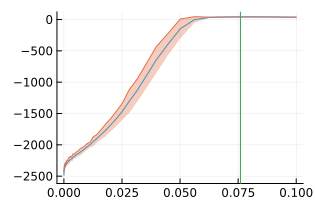

In [31]:
beta_val = -5:0.05:-1;
beta_likelihoods = CSV.read("./output/synthetic/real_model_SparseSynth_beta_likelihoods_no_priors.csv", DataFrame);

plt = Plots.plot(leg=false, title="", size=(width_px/2, width_px/3))
Plots.plot!(plt, [10^(b) for b in beta_val], beta_likelihoods[:, "Likelihood"])
Plots.plot!(plt, [10^(b) for b in beta_val], beta_likelihoods[:, "Likelihood"]+1.96*beta_likelihoods[:, "Std_Error"], fillrange=beta_likelihoods[:, "Likelihood"]-1.96*beta_likelihoods[:, "Std_Error"], fillalpha=0.35)
Plots.plot!(plt,[0.076],  seriestype="vline")
Plots.savefig(plt, "./figures/seir_synth_beta_likelihoods.pdf")
plt

Interestingly for beta that near zero it drops not to minus large values.

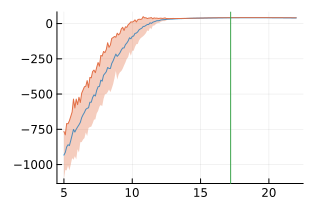

In [32]:
gamma_val = 5:0.1:22;
gamma_likelihoods = CSV.read("./output/synthetic/real_model_SparseSynth_gamma_likelihoods_no_priors.csv", DataFrame);

plt = Plots.plot(leg=false, title="", size=(width_px/2, width_px/3))
Plots.plot!(plt, gamma_val, gamma_likelihoods[:, "Likelihood"])
Plots.plot!(plt, gamma_val, gamma_likelihoods[:, "Likelihood"]+1.96*gamma_likelihoods[:, "Std_Error"], fillrange=gamma_likelihoods[:, "Likelihood"]-1.96*gamma_likelihoods[:, "Std_Error"], fillalpha=0.35)
Plots.plot!(plt,[17.2],  seriestype="vline")
Plots.savefig(plt, "./figures/seir_synth_gamma_likelihoods.pdf")
plt

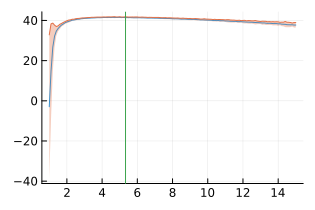

In [33]:
kappa_val = 1:0.1:15;
kappa_likelihoods = CSV.read("./output/synthetic/real_model_SparseSynth_kappa_likelihoods_no_priors.csv", DataFrame);

plt = Plots.plot(leg=false, title="", size=(width_px/2, width_px/3))
Plots.plot!(plt, kappa_val, kappa_likelihoods[:, "Likelihood"])
Plots.plot!(plt, kappa_val, kappa_likelihoods[:, "Likelihood"]+1.96*kappa_likelihoods[:, "Std_Error"], fillrange=kappa_likelihoods[:, "Likelihood"]-1.96*kappa_likelihoods[:, "Std_Error"], fillalpha=0.35)
Plots.plot!(plt,[5.33],  seriestype="vline")
Plots.savefig(plt, "./figures/seir_synth_kappa_likelihoods.pdf")
plt

Again this large plateau like behaviour.

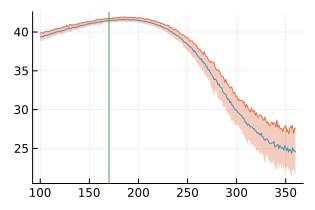

In [34]:
t_val = 100:1:360;
t_likelihoods = CSV.read("./output/synthetic/real_model_SparseSynth_t_likelihoods_no_priors.csv", DataFrame);

plt = Plots.plot(leg=false, title="", size=(width_px/2, width_px/3))
Plots.plot!(plt, t_val, t_likelihoods[:, "Likelihood"])
Plots.plot!(plt, t_val, t_likelihoods[:, "Likelihood"]+1.96*t_likelihoods[:, "Std_Error"], fillrange=t_likelihoods[:, "Likelihood"]-1.96*t_likelihoods[:, "Std_Error"], fillalpha=0.35)
Plots.plot!(plt,[170],  seriestype="vline")
Plots.savefig(plt, "./figures/seir_synth_t_likelihoods.pdf")
plt

Looks like I had am typo in creating the data out of the loaded observations... This might give this weird results as well.

### Data check
Since it is not possible to plot the likelihood landscape dependent on all parameters, I check the "goodness" of a vector by using an EnsembleProblem, which outputs the observable 9%-CIs and plot it against the data.

First with the true parameter.

In [42]:
plt_true1, plt_true2 = data_check_plot(SDE_problem, true_params, tobs, y_load);

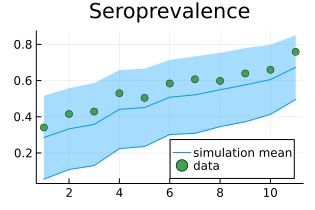

In [58]:
Plots.plot(plt_true1, title="Seroprevalence", size=(width_px/2, width_px/3), leg=:bottomright)

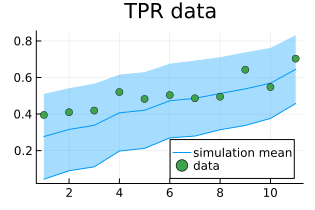

In [59]:
Plots.plot(plt_true2, title="TPR data", size=(width_px/2, width_px/3), leg=:bottomright)

Now with the best from the likelihood run.

## Decide particle number

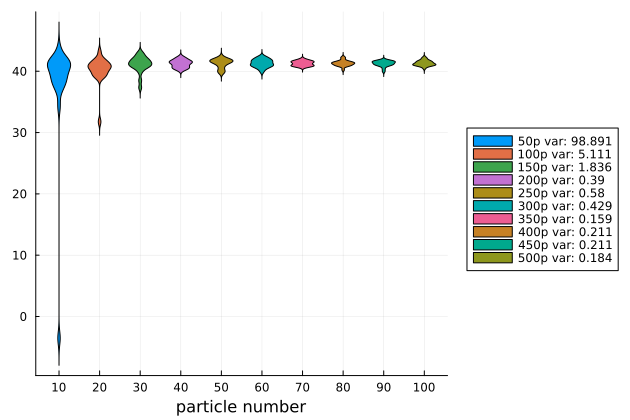

In [190]:
var_plt = my_plot_llh_vs_nparticles(ssm, SDE_problem.p, real_data, [50,100,150,200,250,300,350,400,450,500])

So the violin plots indicate a particle number of 400. Lets plots the genealogicla tree for that.

In [11]:
nparticles =200
bf = BootstrapFilter(ssm, real_data)
pf = SMC(bf, SDE_problem.p, nparticles, ParticleHistoryLength(; didresample=FullHistory(), ancestors=FullHistory(),
                                                            logCnorm=StaticFiniteHistory{1}()),
        AdaptiveResampling(SystematicResampling(), 0.5),);

In [12]:
offlinefilter!(pf);

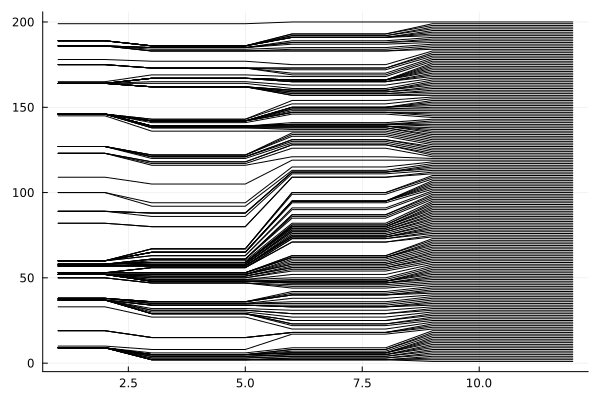

In [15]:
tree_plt = plot_ancestor_tree(pf.history_pf.ancestors)

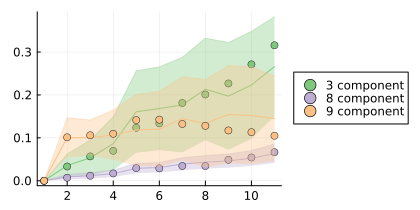

In [40]:
 # use just the recovered compartments <-- they are not scaled!!!
filter_plt = my_plot_filter(ssm, SDE_problem.p, [3,8,9], tobs, nparticles=500)
filter_plt = Plots.plot(filter_plt, leg=:outerright, size=(width_px/1.5,width_px/3))

## Results

Burn In: 20000
4×2 DataFrame
 Row │ MSJD     acceptance_rate 
     │ Float64  Any             
─────┼──────────────────────────
   1 │ 3.24015  0.7619
   2 │ 3.06912  0.768433
   3 │ 3.26089  0.766767
   4 │ 3.0747   0.7668
4×8 DataFrame
 Row │ parameters  mean        std         naive_se    mcse        ess      rhat     ess_per_sec 
     │ Symbol      Float64     Float64     Float64     Float64     Float64  Float64  Float64     
─────┼───────────────────────────────────────────────────────────────────────────────────────────
   1 │ beta          0.086085   0.0159338  4.59953e-5  0.00020399  6268.43  1.00042     0.409589
   2 │ gamma        17.4823     3.41415    0.00985546  0.0426081   6703.0   1.00019     0.437985
   3 │ kappa         5.09468    0.485999   0.00140291  0.00539946  7981.1   1.00061     0.521497
   4 │ tevent      209.821     29.2443     0.0844183   0.351901    7814.52  1.00141     0.510613

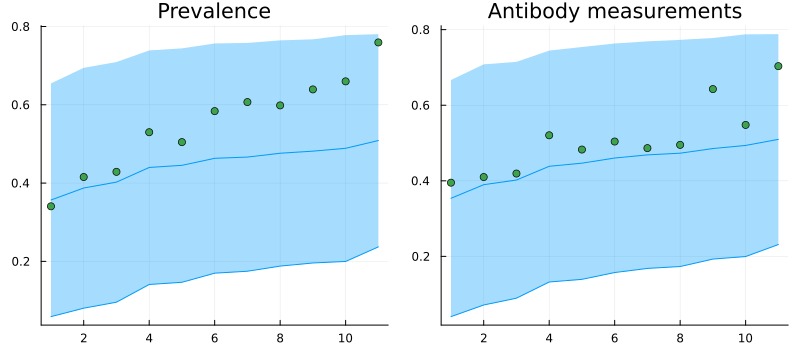

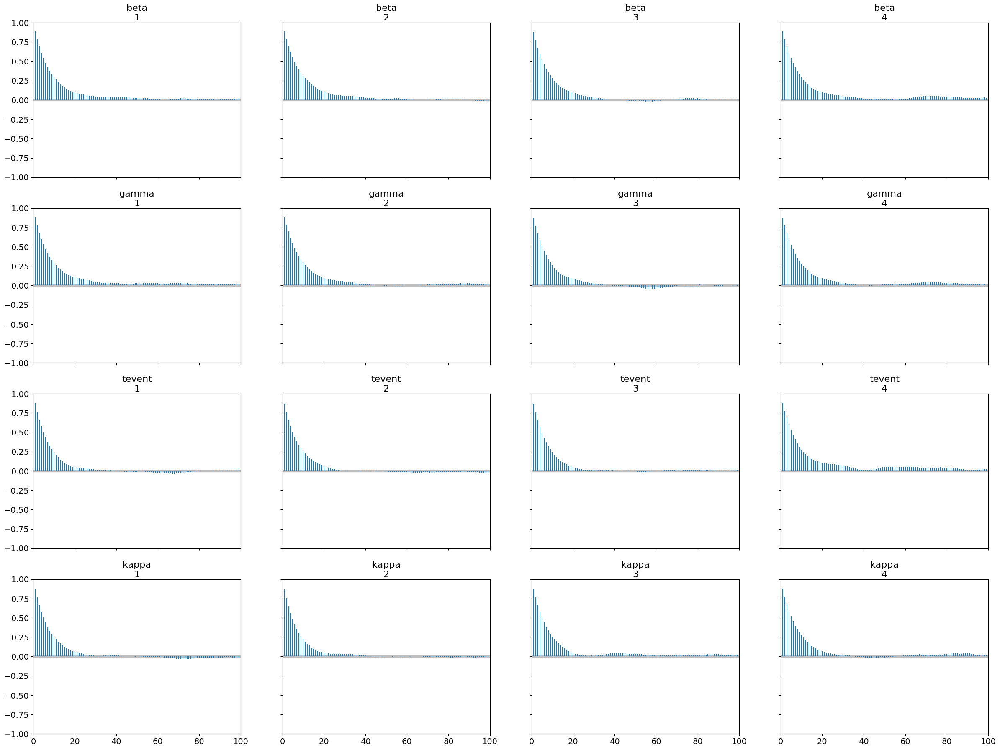

In [28]:
chain = h5open("./output/synthetic/adapt_SparseSynth_4chs_50000it_200p.h5", "r") do f
   read(f, Chains)
end
time = open("./output/synthetic/time_real_synth_4chs_100000it_100p.txt", "r") do f
   read(f, Float64)
end
chain = setinfo(chain, (start_time=0.0, stop_time=time));
evaluate_synth_chain(SDE_problem, chain, tobs, y_load, ["beta", "gamma", "kappa", "tevent"])